# Ashwin Rao (2019101049)

This notebook contains code, results, observations and explanations. Observations are explained visually using plots.  
Functions are well documented and self-explanatory.  

In [1]:
import numpy as np
import random
import matplotlib.pyplot as plt
import cv2
import glob
import os

# Q1: Direct Linear Transform (DLT) Implementation

- DLT is a camera calibration technique.
- Given a set of 2D-3D correspondences, DLT estimates the camera matrix P.
- We can then decompose P into K, R and t (camera intrinsics and extrinsics).
- DLT needs at least 6 correspondences. All of them should not lie on the same plane.

### How DLT works
- The camera matrix P has 11 parameters to calculate (P[3, 4] is anchored to 1).
- Each 2D-3D correspondence gives us 2 equations. Represented in matrix form, these are:

$$
\begin{bmatrix}
   X_{i} & Y_{i} & Z_{i} & 1 & 0 & 0 & 0 & 0 & -X_{i}*x_{i} & -Y_{i}*x_{i} & -Z_{i}*x_{i} &  -x_{i}       \\
   0 & 0 & 0 & 0 &  X_{i} & Y_{i} & Z_{i} & 1 & -X_{i}*y_{i} & -Y_{i}*y_{i} & -Z_{i}*y_{i} &  -y_{i} 
\end{bmatrix}
\begin{bmatrix}
    p_{11}  \\
      p_{12} \\
       p_{13} \\ 
         p_{14}     \\
    p_{21}  \\
      p_{22} \\
       p_{23}  \\
         p_{24}     \\  
    p_{31}  \\
      p_{32} \\
       p_{33}  \\
         p_{34}     
\end{bmatrix} 
= 
\begin{bmatrix}
    0 \\   
\end{bmatrix} 
$$

If we have $n$ correspondences, A will have $ 2n $ rows.  
Hence with $n >= 6$, we get a homogeneous system of equations:
$$
A_{(2nx12)}P_{(12x1)} = 0
$$

To solve for $P$, we minimize $||AP||^2$ to bring it close to 0. This is done as follows:
- Apply SVD on $A$ to get $A = UDV^T$.  
- Set P to the vector in $V^T$ corresponding to the smallest eigenvalue in $D$.  
- This gives us $P = V_{12}$.

In [2]:
def DLT(x, X):
    """
    :param x: list of image points (homogenized)
    :param X: list of world points (homogenized)
    :return: Camera matrix P
    """
    
    A = []
    
    # find equations for each correspondence
    for (xi, yi, _), (Xi, Yi, Zi, _) in zip(x, X):
        A.append([Xi, Yi, Zi, 1, 0, 0, 0, 0, -Xi * xi, -Yi * xi, -Zi * xi, -xi])
        A.append([0, 0, 0, 0, Xi, Yi, Zi, 1, -Xi * yi, -Yi * yi, -Zi * yi, -yi])
    
    A = np.array(A)
    
    # solve for P
    U, D, VT = np.linalg.svd(A)
    P = VT[-1, :].reshape(3, 4)
    P /= P[-1, -1]
    
    return P

In [3]:
def findReprojectionError(x, X, P):
    """
    :param x: list of all image points (homogenized)
    :param X: list of all world points (homogenized)
    :return: reprojection error
    """
    
    # convert to numpy arrays
    x = np.array(x).T
    X = np.array(X).T
    
    x_calc = P @ X
    x_calc /= x_calc[-1]
    
    return np.mean(np.linalg.norm(x - x_calc, axis=0))

In [4]:
def getReprojectedPoints(X, P):
    """
    :param X: list of all world points (homogenized)
    :return: list of all reprojected image points (not homogenized)
    """
    
    # convert to numpy array
    X = np.array(X).T
    
    x_calc = P @ X
    x_calc /= x_calc[-1]
    
    return (x_calc[:-1].T).tolist()

In [5]:
def get_KRT_from_P(P):
    """
    :param P: Camera matrix
    :return: Camera intrinsics K
    :return: Rotation matrix R
    :return: Translation vector t
    """
    
    H = P[:, :-1]
    h = P[:, -1].reshape(3, 1)
    
    # QR decomposition
    H_inv = np.linalg.inv(H)
    RT, K_inv = np.linalg.qr(H_inv)
    
    R = RT.T
    K = np.linalg.inv(K_inv)
    K /= K[-1, -1]
    t = K_inv @ h
    
    return K, R, t

In [6]:
def get_P_from_KRT(K, R, t):
    """
    :param K: Camera intrinsics
    :param R: Rotation matrix
    :param t: Translation vector
    :return: Camera matrix P
    """
    
    P = K @ np.hstack((R, t))
    P /= P[-1, -1]
    return P

# Q2: RANSAC + DLT Implementation

- RANSAC iteratively tries to find the best camera matrix (using DLT) by randomly choosing correspondences.
- In each iteration, we choose 6 correspondences randomly and calculate the camera matrix P using DLT.
- We count the number of inliers by reprojecting all world points using the above calculated P.
- A world point is an inlier if its reporjected point is close to the original image point (this distance is decided by a certain threshold). 
- The camera matrix which results in the most number of inliers is chosen.

In [7]:
def getNumIters(p, w):
    """
    :param p: desired probability of success
    :param w: estimated fraction of inliers in the data
    :return: number of iterations for RANSAC
    """
    
    return int(np.log(1 - p) / np.log(1 - w**3))

In [8]:
def ransac(x, X, threshold=1e-3):
    """
    :param x: list of all image points (homogenized)
    :param X: list of all world points (homogenized)
    :return: Camera matrix P
    """
    
    # convert to numpy arrays
    x_arr = np.array(x).T
    X_arr = np.array(X).T
        
    max_inliers = 0
    P_final = None
    
    num_iters = 500
    for i in range(num_iters):
        # choose n correspondences randomly
        n = 6
        rand_points = random.sample(list(zip(x, X)), n)
        x_rand, X_rand = map(list, zip(*rand_points))
        
        # ignore if all correspondences lie on a single plane
        if ((np.array(X_rand) == 0).all(axis=0)).any():
            continue
        
        # find calibration
        P = DLT(x_rand, X_rand)
        
        # count inliers
        x_calc = P @ X_arr
        x_calc /= x_calc[-1]
        
        dists = np.linalg.norm(x_arr - x_calc, axis=0)
        inliers = np.sum(dists < threshold)
        
        # check if calibration matrix results in more inliers
        if inliers > max_inliers:
            max_inliers = inliers
            P_final = P
    
    return P_final

# Q6 (a): Zhang's Technique Implementation

- We use Zhang's method to calculate the camera intrinsic matrix K and extrinsics R and t for each checkerboard image. The distortion parameters are also calculated, using which we can undistort images taken by the camera.

In [9]:
def eulerAnglesToRotationMatrix(theta):
    print(theta)
    
    R_x = np.array([[1, 0, 0],
                    [0, np.cos(theta[0]), -np.sin(theta[0])],
                    [0, np.sin(theta[0]),  np.cos(theta[0])]])
    
    R_y = np.array([[np.cos(theta[1]), 0, np.sin(theta[1])],
                    [0, 1, 0],
                    [-np.sin(theta[1]), 0, np.cos(theta[1])]])             
    
    R_z = np.array([[np.cos(theta[2]), -np.sin(theta[2]), 0],
                    [np.sin(theta[2]),  np.cos(theta[2]), 0],
                    [0, 0, 1]])
    
    R = np.dot(R_z, np.dot(R_y, R_x))
    return R

In [10]:
def findCheckerBoardCorners(dir_path):
    """
    :param dir_path: path to checkerboard images (pattern match image names)
    :return: list of numpy array (shape n x 3) of world points for each image (not homogenized)
    :return: list of numpy array (shape n x 1 x 2) of image points for each image (not homogenized)
    :return: shape of checkerboard images
    """
    
    # termination criteria
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

    # grid size
    r, c = 8, 6

    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ...., (6,5,0)
    objp = np.zeros((r * c, 3), np.float32)
    objp[:, :2] = np.mgrid[0:r, 0:c].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d point in real world space
    imgpoints = [] # 2d points in image plane

    print("Loading images...")

    # get images
    images = glob.glob(dir_path)
    images = [cv2.imread(img) for img in images]
    shape = images[0].shape[:-1]
    
    # populate object and image points
    for i, img in enumerate(images):
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Find the chess board corners
        found, corners = cv2.findChessboardCorners(gray, (r, c), None)

        # If found, add object points, image points (after refining them)
        if found:
            objpoints.append(objp)
            corners2 = cv2.cornerSubPix(gray, corners, (11, 11), (-1, -1), criteria)
            imgpoints.append(corners2)

            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (r,c), corners2, found)
            plt.title(f"Image {i+1}")
            plt.imshow(img)
            plt.axis("off")
            plt.show()
        
    return objpoints, imgpoints, shape

In [11]:
def zhangs(world_points, img_points, shape):
    """
    :param world_points: list of numpy array of world points for each image (not homogenized)
    :param img_points: list of numpy array of img points for each image (not homogenized)
    :shape img_shape: shape of checkerboard images
    :return K: Camera intrinsic matrix
    :return rvecs: List of rotation vectors for each image
    :return tvecs: List of translation vectors for each image
    :return P_list: List of camera matrix P for each image
    :return dist: Numpy array (1 x 5) of distortion coefficients
    """
    
    ret, K, dist, rvecs, tvecs = cv2.calibrateCamera(world_points, img_points, shape[::-1], None, None)
    
    # caluculate P for each image
    P_list = []
    for r, t in zip(rvecs, tvecs):
        R, _ = cv2.Rodrigues(r)
        P = get_P_from_KRT(K, R, t)
        P_list.append(P)
        
    return K, rvecs, tvecs, P_list, dist

In [12]:
def findReprojectionErrors(world_points, img_points, P_list, dir_path):
    """
    :param world_points: list of world points for each image (homogenized)
    :param img_points: list of image points for each image (homogenized)
    :param P_list: list of camera matrix P for each image
    :param dir_path: path to checkerboard images (pattern match image names)
    :return: list of reprojection errors for all checkerboard images
    """
    
    images = glob.glob(dir_path)
    errors = []
    
    # find reprojection error for each image
    for i, img_path in enumerate(images):
        img = cv2.imread(img_path)

        # world points of current image
        X = world_points[i]
        
        # image points of current image
        x = img_points[i]
        
        # calculate P
        P_zhangs = P_list[i]
        
        # calculate reprojection error
        error = findReprojectionError(x, X, P_zhangs)
        errors.append(error)
    
    return errors

# Q3: Camera Calibration using DLT and RANSAC

In [13]:
def homogenize(x):
    """
    :param x: list of correspondences (2D or 3D)
    :return: list of homogenized correspondences
    """
    
    return np.hstack((x, np.ones((len(x), 1)))).tolist()

In [14]:
def getImagePoints(img_path):
    """
    :param img_path: path to image
    :return: list of image coordinates of selected world points
    """
    
    %matplotlib tk
    image_points = []
    fig = plt.figure(figsize=(20,30))
    
    img = cv2.imread(img_path)
    
    def onclick(event):
        ix, iy = event.xdata, event.ydata
        print(ix, iy)
        image_points.append([ix, iy])
    
    cid = fig.canvas.mpl_connect('button_press_event', onclick)
    
    imgplot = plt.imshow(img)
    plt.show()
    
    return image_points

In [15]:
def show2DProjections(image_points, img_path):
    """
    :param image_points: list of image points (2D correspondences)
    :param img_path: path to image
    :return: None
    """
    %matplotlib inline
    
    N = len(image_points)
    image_points = np.array(image_points)
    fig = plt.figure(figsize=(10,15))

    img = cv2.imread(img_path)
    imgplot = plt.imshow(img)

    colors = np.random.rand(N)
    area = (15 * np.ones(N))**2 

    plt.scatter(image_points[:,0], image_points[:,1], c=colors, s=area)
    plt.show()

In [76]:
img_path = "../data/black-dots.JPG"

# generate 2D correspondences for DLT
# image_points = getImagePoints(img_path)

# generated by getImagePoints
image_points = [[4734.317466037505, 2455.6754762908467],
                [2382.913410935992, 3398.2214055509467],
                [334.1162068074582, 2401.1070277547356],
                [135.68548485796327, 277.89830289514157],
                [2442.44262752084, 1220.4442321552415],
                [4064.61377945796, 516.0151692345353]]

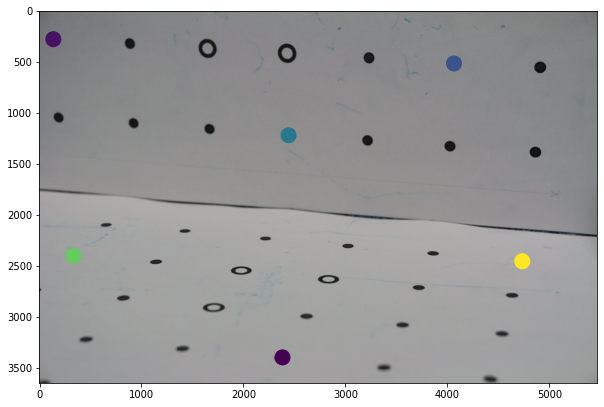

In [77]:
show2DProjections(image_points, img_path)

In [78]:
# all 2D correspondences
# x_all = getImagePoints(img_path)

# generated by getImagePoints
x_all = [[4927.787419938262, 560.6620816731715],
         [4878.1797394508885, 1394.0711138610495],
         [4064.61377945796, 511.0544011857978],
         [4029.888403116799, 1334.5418972762009],
         [3241.1262833675564, 461.4467206984241],
         [3226.2439792213445, 1270.0519126426152],
         [2437.4818594721028, 421.7605763085253],
         [2447.4033955695777, 1220.4442321552415],
         [1653.6805077715983, 372.15289582115156],
         [1673.5235799665477, 1170.8365516678678],
         [894.6829963147809, 327.5059833825153],
         [934.3691407046797, 1111.3073350830196],
         [140.64625290670074, 287.81983899261604],
         [195.2147014428117, 1056.7388865469084],
         [4734.317466037505, 2455.6754762908467],
         [4645.023641160233, 2783.086167507513],
         [3871.143825557203, 2376.3031875110487],
         [3732.2423201925567, 2708.6746467764524],
         [3037.7347933693245, 2306.8524348287256],
         [2849.2256075173045, 2629.302357996655],
         [2229.129601425133, 2237.4016821464024],
         [1991.0127350857395, 2549.9300692168567],
         [1435.406713627154, 2162.990161415342],
         [1157.6037028978615, 2465.5970123883217],
         [666.4876660728619, 2103.460944830493],
         [339.0769748561954, 2406.067795803473],
         [4550.769048234222, 3170.026075309028],
         [4436.671383113263, 3616.495199695391],
         [3563.5762065354857, 3085.6930184804924],
         [3389.9493248296776, 3492.475998476957],
         [2630.9518133728598, 2996.39919360322],
         [2387.874178984729, 3403.182173599684],
         [1713.209724356447, 2902.14460067721],
         [1415.5636414322046, 3308.927580673674],
         [830.193011681195, 2812.8507757999373],
         [463.09617607462974, 3219.6337557964016]]

# all 3D correspondences
X_all = []
for x in range(0, 7):
    for y in range(2, 0, -1):
        X_all.append([x * 36, y * 36, 0])

for x in range(0, 6):
    for z in range(1, 3):
        X_all.append([x * 36, 0, z * 36])
        
for x in range(0, 5):
    for z in range(3, 5):
        X_all.append([x * 36, 0, z * 36])
        
# homogenized correspondences
x_all_homogenized = homogenize(x_all)
X_all_homogenized = homogenize(X_all)

In [79]:
# 2D correspondences for DLT
x = image_points

# 3D correspondences for DLT
X = []
X.append([0, 0, 36])
X.append([72, 0, 144])
X.append([180, 0, 72])
X.append([216, 72, 0])
X.append([108, 36, 0])
X.append([36, 72, 0])

# homogenized correspondences
x_homogenized = homogenize(x)
X_homogenized = homogenize(X)

In [80]:
# calibration using DLT
P_dlt = DLT(x_homogenized, X_homogenized)
K_dlt, R_dlt, t_dlt = get_KRT_from_P(P_dlt)

print("P found using DLT: \n", P_dlt)
print("K found using DLT: \n", K_dlt)

P found using DLT: 
 [[-2.09698694e+01 -1.90104907e+00 -9.96333619e+00  4.80316191e+03]
 [-1.15447723e+00 -2.26844606e+01  3.90609296e+00  2.16959503e+03]
 [ 3.13898221e-04 -6.78139436e-04 -1.68813721e-03  1.00000000e+00]]
K found using DLT: 
 [[-1.21561316e+04  1.98786610e+00  3.38190487e+03]
 [-0.00000000e+00 -1.22367585e+04  2.47250378e+03]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]


In [83]:
# calibration using RANSAC
P_ransac = ransac(x_all_homogenized, X_all_homogenized)
K_ransac, R_ransac, t_ransac = get_KRT_from_P(P_ransac)

print("P found using RANSAC: \n", P_ransac)
print("K found using RANSAC: \n", K_ransac)

P found using RANSAC: 
 [[-2.11809338e+01 -1.38435913e+00 -9.56808413e+00  4.82653874e+03]
 [-1.13723716e+00 -2.22933026e+01  4.81183219e+00  2.14450636e+03]
 [ 3.23540401e-04 -5.04369763e-04 -1.49133980e-03  1.00000000e+00]]
K found using RANSAC: 
 [[-1.41415779e+04  7.43131791e+01  3.14134649e+03]
 [-0.00000000e+00 -1.41353754e+04  1.43237211e+03]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]


In [84]:
# reprojection errors using DLT and RANSAC
print("Reprojection error using DLT: ", findReprojectionError(x_all_homogenized, X_all_homogenized, P_dlt))
print("Reprojection error using RANSAC: ", findReprojectionError(x_all_homogenized, X_all_homogenized, P_ransac))

Reprojection error using DLT:  11.117865601233513
Reprojection error using RANSAC:  12.350098048030196


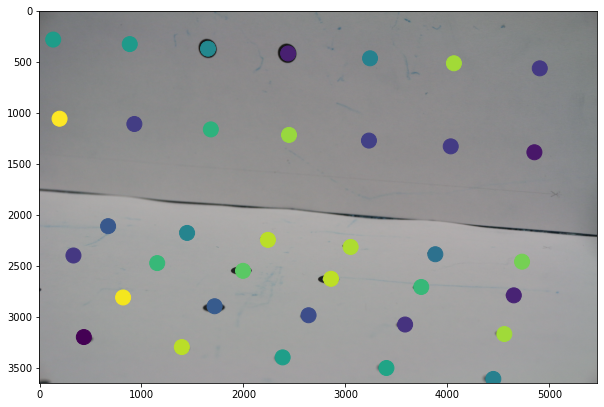

In [85]:
# reproject all world points using DLT
reprojected_points_dlt = getReprojectedPoints(X_all_homogenized, P_dlt)
show2DProjections(reprojected_points_dlt, img_path)

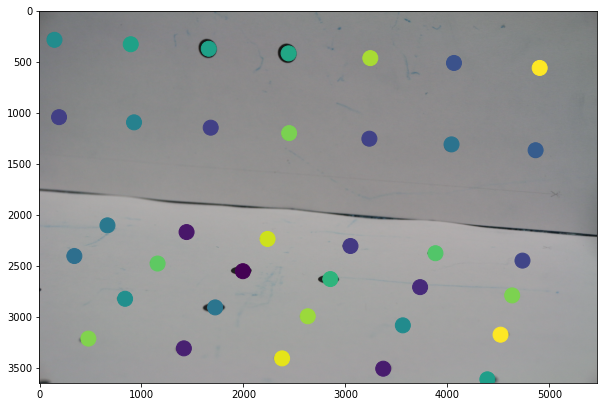

In [86]:
# reproject all world points using RANSAC
reprojected_points_ransac = getReprojectedPoints(X_all_homogenized, P_ransac)
show2DProjections(reprojected_points_ransac, img_path)

## Observations

### DLT
- We choose 6 correspondences manually and observe the reprojection error.
- DLT peforms very well with the chosen 6 correspondences. The chosen world points lie on 2 different planes and are sufficiently spread apart to cover a large portion of the image. 
- For the chosen correspondences, the reprojection error is 11.11.

### RANSAC
- RANSAC randomly chooses 6 correspondences from the set of all correspondences to calculate the camera matrix.
- RANSAC performs better with higher number of iterations (~100). Since it is a random algorithm, the reprojection error changes each time we run the algorithm.
- The reprojection error obtained using RANSAC usually varies between 9 and 40.
- In cases where RANSAC gives a high reprojection error, this is probably due to the random correspondences not covering the entire image, but rather being localized in a subregion of the image. When such a case is plotted, projections will overlap well in some areas but poorly in other areas.

### Comparison
- We cannot draw any conclusions by directly comparing the P and K matrices obtained from both methods. We compare the reprojection error obtained using both algorithms.
- DLT usually performs better than RANSAC, and gives a lower reprojection error for the chosen correspondences.
- The performance of the algorithms is verified visually by looking at the plots of reprojected points above. In both cases, the projected image points are close to the actual locations of the image points. This tells us that both algorithms perform well.
- The performance of the algorithms can also be verified visually by looking at the wireframes generated in question 5. The overlay fits well in both cases, indicating that the camera is well calibrated using both DLT and RANSAC.

# Q4: Radial Distortion Correction

- We use Zhang's method to calibrate the camera. This gives us camera intrinsics, extrinsics and distortion coefficients.
- We use the distortion coefficients to undistort the image.

There are 2 types of distortion: radial and tangential. These are non-linear functions of squared distance from the center of the image (c): 
$$ r^2 = x^2 + y^2 $$.

### Radial distortion (barrel or pincushion)
There are 3 radial distortion parameters $k_1$, $k_2$ and $k_3$.  
Radial distortion is given by:

$$  x_{distorted} = x \cdot (1 + k_1 \cdot r^2+ k_2 \cdot r^4 + k_3 \cdot r^6) $$
$$  y_{distorted} = y \cdot (1 + k_1 \cdot r^2+ k_2 \cdot r^4 + k_3 \cdot r^6) $$

### Tangential distortion
There are 2 tangential distortion parameters $p_1$ and $p_2$.  
Tangential distortion is given by:

$$ x_{distorted} = x + [2p_1xy + p_2 (r^2 + 2x^2)] $$
$$ y_{distorted} = y + [2p_2xy + p_1 (r^2 + 2y^2)] $$

### Distortion calculation
We need to solve for 5 distortion parameters: $k_1$, $k_2$, $k_3$, $p_1$ and $p_2$.

- Camera intrinsics, extrinsics and distortion parameters are calculated using Zhang's method.
- Using the intrinsic matrix $ K $ and radial distortion parameters, we undistort the given image using the model above.

The undistorted image is found using ```cv2.undistort``` which does the following for each pixel of the destination (undistorted) image:

- Convert the pixel coordinates to normalized coordinates using the inverse of the intrinsic matrix $ K^{-1}$.
- Apply the distortion model above to obtain the distorted normalized coordinates.
- Convert these normalized coordinates to distorted pixel coordinates using the intrinsic matrix $ K $.
- Find the intensity of the pixel coordinates in the source (distorted) image and assign it to the current pixel in the destination (undistorted) image using an interpolation method.

Optionally, before calling ```cv2.undistort```, we use ```cv2.getOptimalNewCameraMatrix``` to refine the intrinsic matrix $ K $ to remove unwanted pixels at the edges of the undistorted image.

In [25]:
def undistortImage(img, K, dist_coefs):
    """
    :param img: image to be undistorted
    :param K: Intrinsic camera matrix obtained after calibration
    :param dist_coefs: List of distortion coefficients obtained after calibration
    :return undistorted: undistorted image
    """
    
    h, w = img.shape[:2]
    
    # undistort image
    K_new, roi = cv2.getOptimalNewCameraMatrix(K, dist_coefs, (w, h), 1, (w, h))
    undistorted = cv2.undistort(img, K, dist_coefs, None, K_new)
    
    # crop image
    x, y, w, h = roi
    undistorted = undistorted[y : y + h, x : x + w]
    
    return undistorted

In [26]:
def plotDistortion(img, undistorted):
    """
    :param img: old (distorted) image
    :param undistorted: new (undistorted) image
    :return: None
    """
    
    # display images
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 15))
    ax1.set_title("Original Image")
    ax1.axis("off")
    ax1.imshow(img)
    ax2.set_title("Undistorted Image")
    ax2.axis("off")
    ax2.imshow(undistorted)

Loading images...


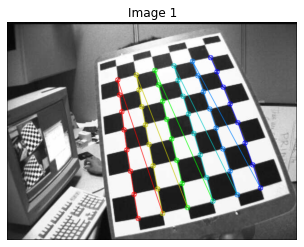

In [27]:
dir_path = "../images/radial-dist-*.jpg"
world_points, img_points, shape = findCheckerBoardCorners(dir_path)

In [28]:
# calibration using Zhangs
K_zhangs, rvecs, tvecs, P_zhangs_list, dist_coefs = zhangs(world_points, img_points, shape)
print("K found using Zhangs: \n", K_zhangs)

K found using Zhangs: 
 [[618.65738966   0.         324.52226055]
 [  0.         629.57190491 207.67148092]
 [  0.           0.           1.        ]]


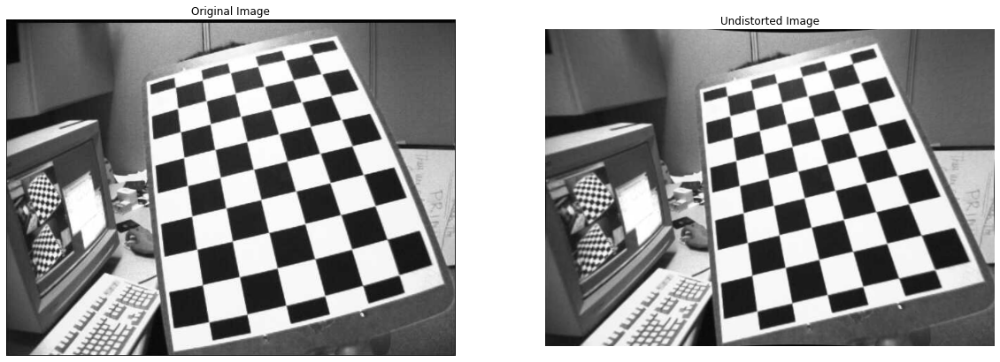

In [29]:
img = cv2.imread("../images/radial-dist-01.jpg")

# undistort image and plot it
undistorted_img = undistortImage(img, K_zhangs, dist_coefs)
plotDistortion(img, undistorted_img)

In [30]:
# distortion coefficients
print("Distortion coefficients: \n", dist_coefs)

Distortion coefficients: 
 [[-0.38916357 -0.02027911  0.01960166  0.01219856  0.41543109]]


## Observations
- In the original image, lines of the checkerboard are not straight. It is clear that this image suffers from barrel distortion.
- In the undistorted image, the lines of the checkerboard have become straight. The removal (or reduction) in the non-linear distortion is clear.
- However, the distortion has not been removed completely. Notice that even in the undistorted image, the right boundary of the checkerboard is slightly curved.
- By looking at the distortion coefficients, we observe that the radial distortion was greater than the tangential distortion. Coefficients $ k2 $ and $ k3 $ are larger in magnitude, while $ p1 $ and $ p2 $ are smaller in magnitude.

# Q5: Wireframe

In [91]:
def drawWireframe(X, P, img_path):
    """
    :param X: list of all world points (homogenized)
    :param P: Camera matrix
    :param img_path: path to image
    :return: None
    """
    
    # reproject points
    x = getReprojectedPoints(X, P)
    x = [list(map(int, point)) for point in x]
    
    # copy image
    img = cv2.imread(img_path)
    img_orig = img.copy()
    
    # draw lines between all points
    for x1 in x:
        for x2 in x:
            cv2.line(img, x1, x2, (0, 0, 255), thickness=2)
    
    # display images
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.set_title("Original Image")
    ax1.axis("off")
    ax1.imshow(img_orig)
    ax2.set_title("Wireframe")
    ax2.axis("off")
    ax2.imshow(img)

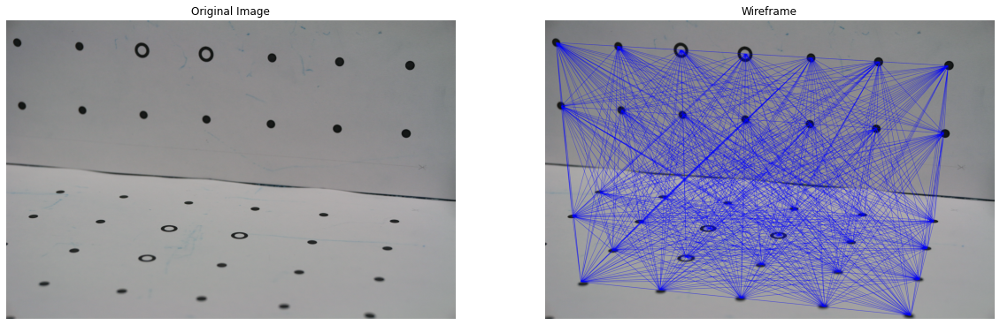

In [92]:
# wireframe of reprojected points using DLT
drawWireframe(X_all_homogenized, P_dlt, img_path)

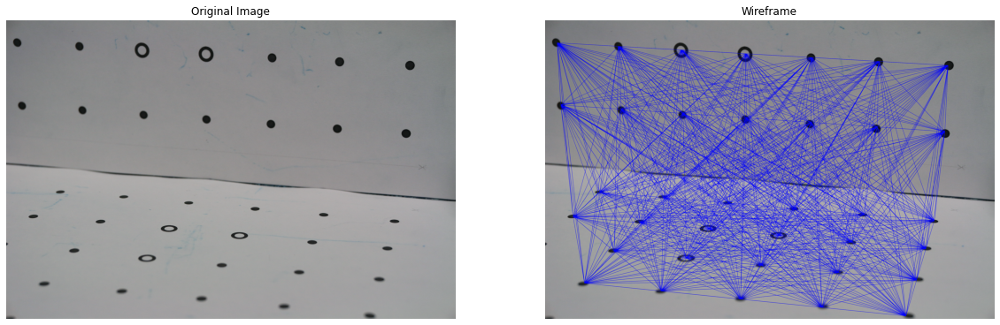

In [93]:
# wireframe of reprojected points using RANSAC
drawWireframe(X_all_homogenized, P_ransac, img_path)

## Observations

- The overlay fits well for both DLT and RANSAC. The reprojected points in both cases are close to the actual locations of the image points.
- This tells us that both algorithms perform well and are able to reproject world points without much error. This indicates that the camera is well calibrated in both cases.
- The overlay obtained using DLT is slightly better (due to lower reprojection error). For example, the top right point is usually matched better using DLT.

# Q6 (b): Camera Calibration using Zhangs Technique

In [34]:
def showReprojectedPoints(world_points, P_list, dir_path):
    """
    :param world_points: list of world points for each image (homogenized)
    :param P_list: list of camera matrix P for each image
    :param dir_path: path to checkerboard images (pattern match image names)
    :return: None
    """
    
    images = glob.glob(dir_path)
    errors = []
    
    # show 2D projections for each image
    for i, img_path in enumerate(images):
        img = cv2.imread(img_path)

        # world points of current image
        X = world_points[i]
        
        # calculate P
        P_zhangs = P_list[i]
        
        # reproject all world points using zhangs
        reprojected_points_zhangs = getReprojectedPoints(X, P_zhangs)
        show2DProjections(reprojected_points_zhangs, img_path)

Loading images...


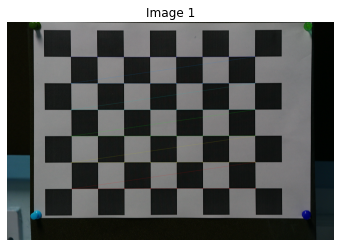

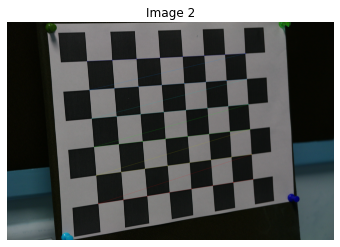

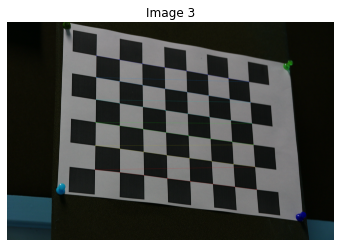

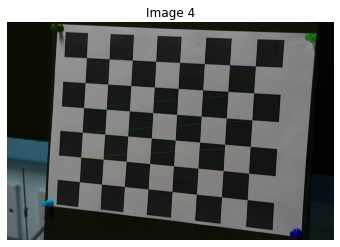

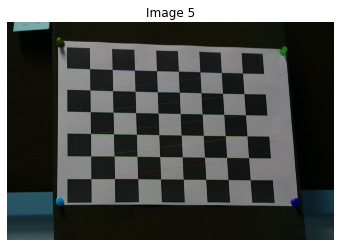

...

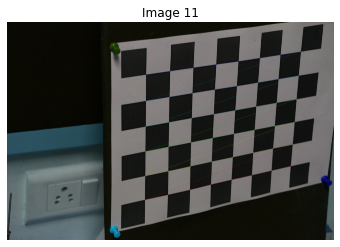

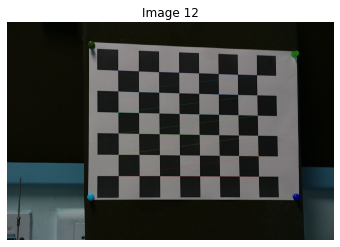

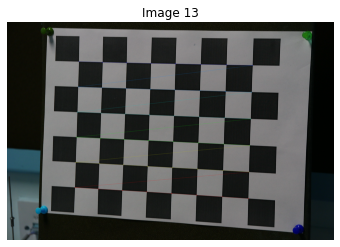

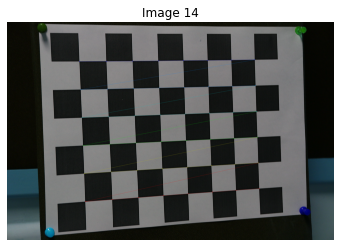

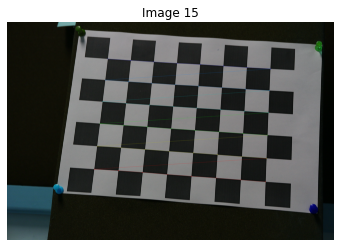

In [35]:
dir_path = "../data/checkerboard-*.JPG"
world_points, img_points, shape = findCheckerBoardCorners(dir_path)

In [36]:
# calibration using Zhangs
K_zhangs, rvecs, tvecs, P_zhangs_list, dist_coefs = zhangs(world_points, img_points, shape)
print("K found using Zhangs: \n", K_zhangs)

K found using Zhangs: 
 [[1.36415095e+04 0.00000000e+00 3.31635924e+03]
 [0.00000000e+00 1.36632518e+04 1.50037425e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


In [37]:
world_points_homogenized = [homogenize(points) for points in world_points]
img_points_homogenized = [homogenize(points) for points in np.squeeze(img_points)]    

In [38]:
# reprojection error for each checkerboard image using Zhangs
errors = findReprojectionErrors(world_points_homogenized, img_points_homogenized, P_zhangs_list, dir_path)
print("Reprojection errors using Zhangs: \n", np.array(errors))

Reprojection errors using Zhangs: 
 [8.10118905 6.82393256 6.31167257 8.02238505 6.75411439 6.53283828
 5.74863349 8.57700529 6.84920619 9.00303192 7.85463848 5.05632594
 8.24053376 7.53143924 6.82931185]


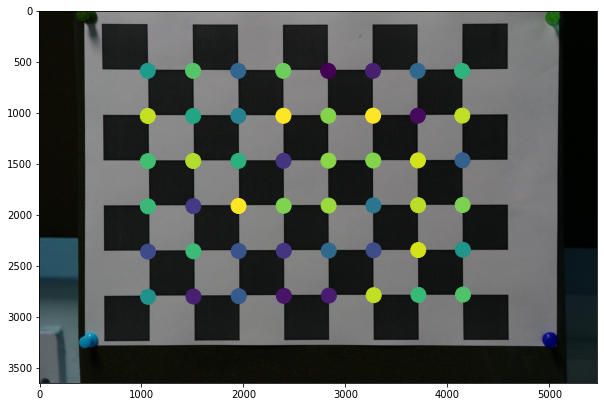

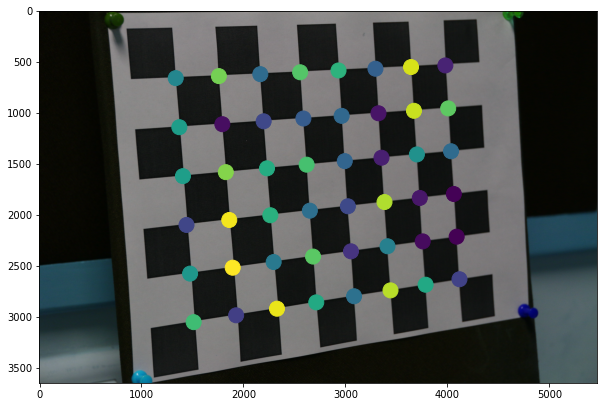

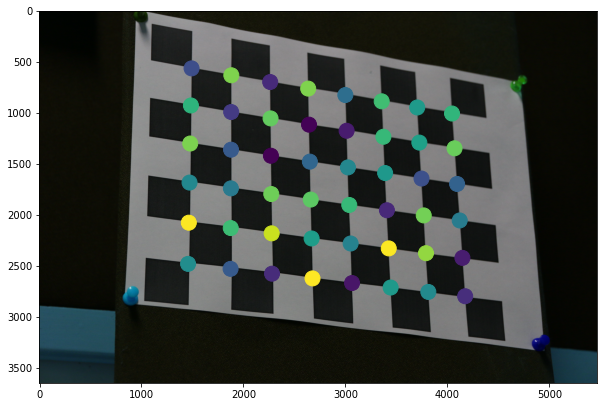

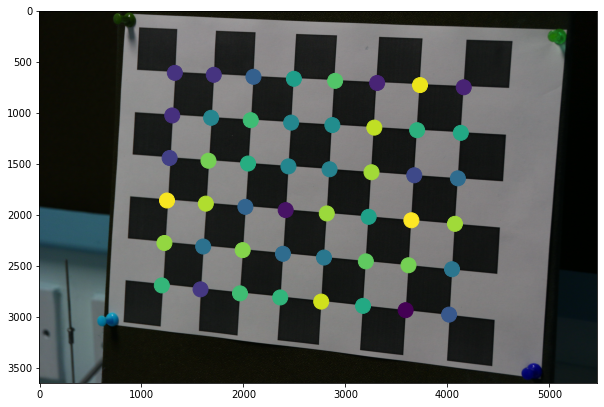

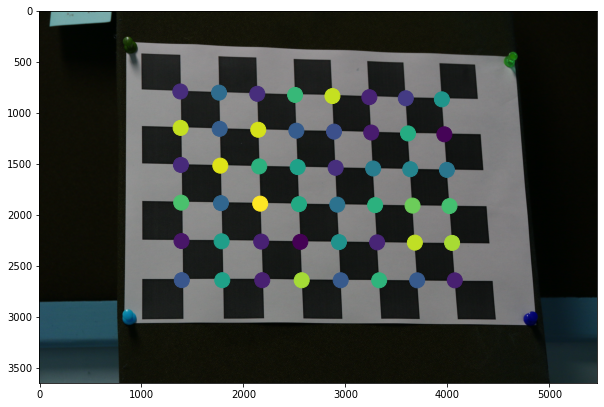

...

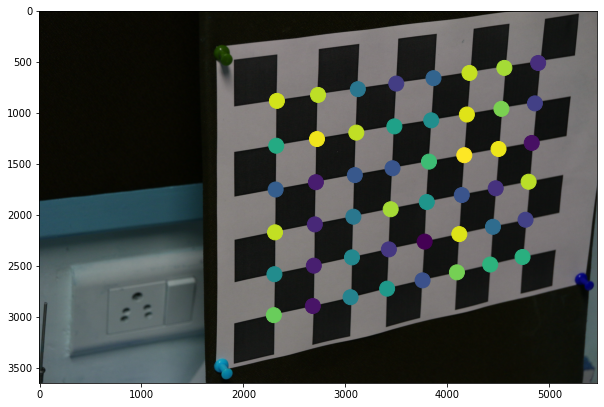

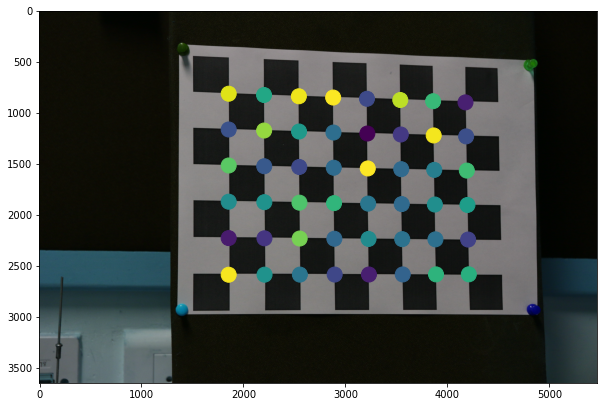

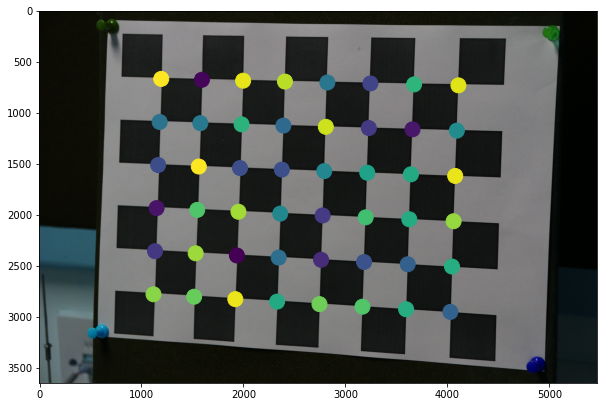

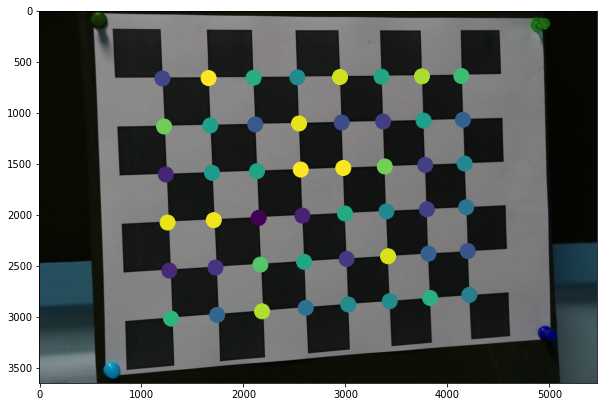

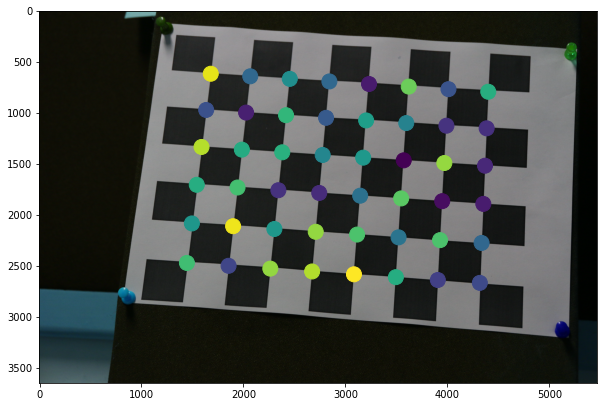

In [39]:
# reproject all world points for each checkerboard image
showReprojectedPoints(world_points_homogenized, P_zhangs_list, dir_path)

## Observations

- Using Zhang's method, we calculate the intrinsic matrix P asnd the extrensics (R and T) for each checkerboard image.
- Using this information, we calculate the reprojection error for each checkerboard image.
- The reprojection errors lie between 5 and 9, lesser than both DLT and RANSAC.
- Hence, Zhang's method, in this case, performs better than both DLT and RANSAC.
- The performance is verified visually by looking at the plots of reprojected points above. In all images, the projected image points are very close to the actual locations of the image points. This tells us that the algorithm is performing well.
- The performance is also verified visually by looking at the wireframes overlayed on the images in question 7. The overlays fit almost perfectly for all images, indicating that the camera is well calibrated.

# Q7: Wireframe

In [40]:
def drawWireframes(world_points, P_list, dir_path):
    """
    :param world_points: list of world points for each image (homogenized)
    :param P_list: list of camera matrix P for each image
    :param dir_path: path to directory containing checkerboard images
    :return: None
    """
    
    images = glob.glob(dir_path)

    # draw wireframe for each image
    for i, img_path in enumerate(images):
        img = cv2.imread(img_path)
        
        # world points of current image
        X = world_points[i]
        
        # calculate P
        P_zhangs = P_list[i]

        # draw wireframe for image i
        drawWireframe(X, P_zhangs, img_path)

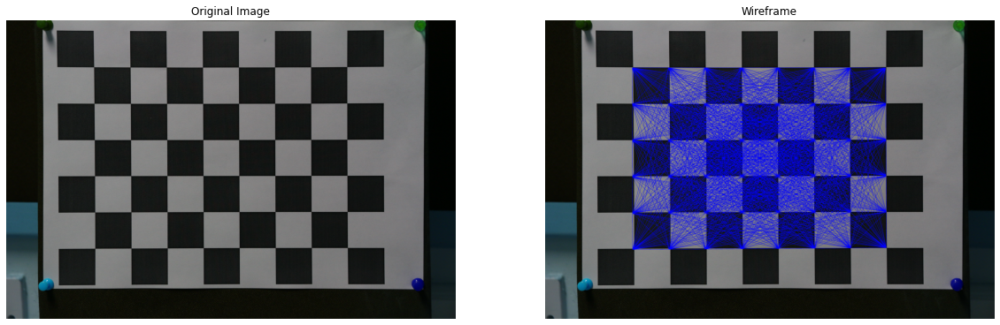

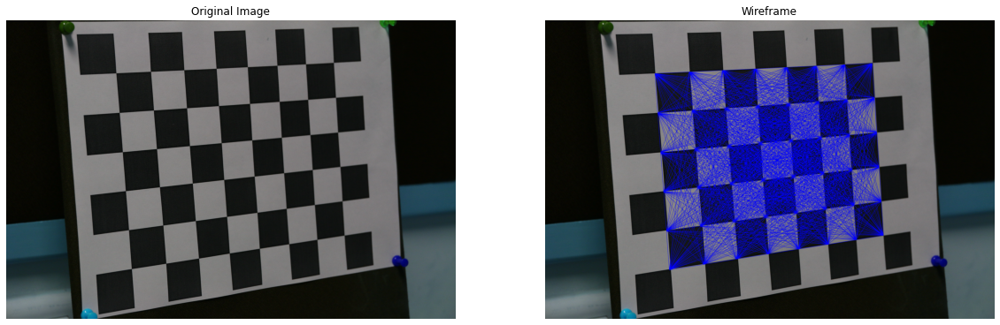

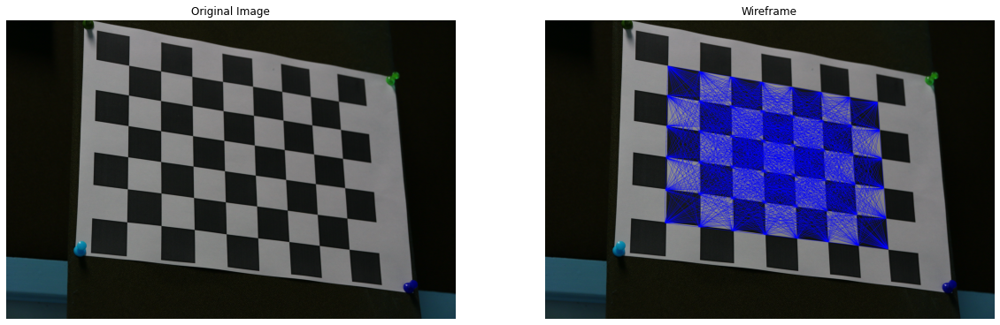

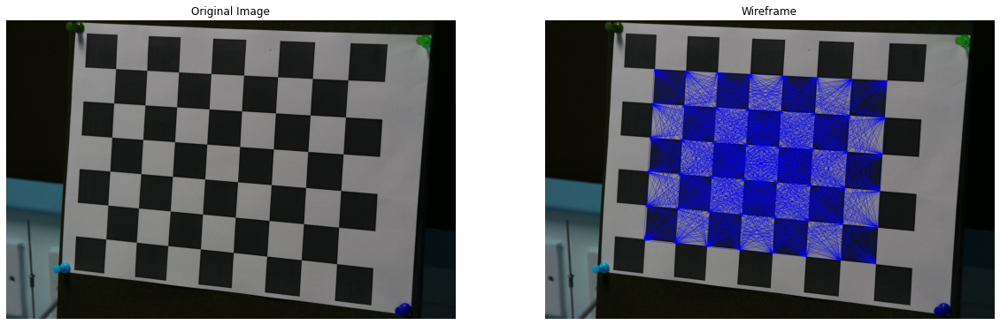

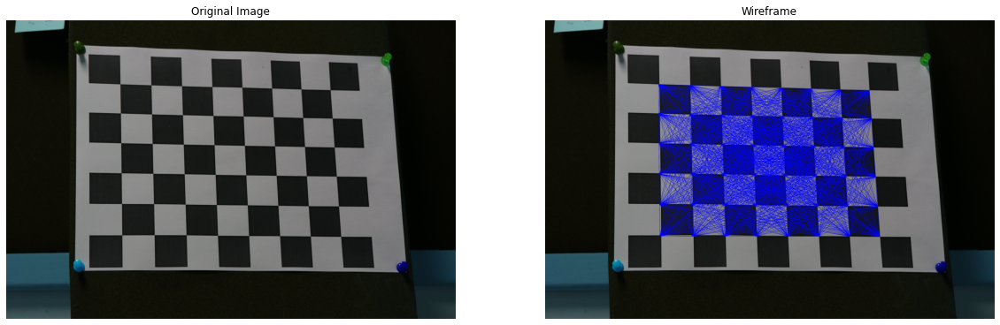

...

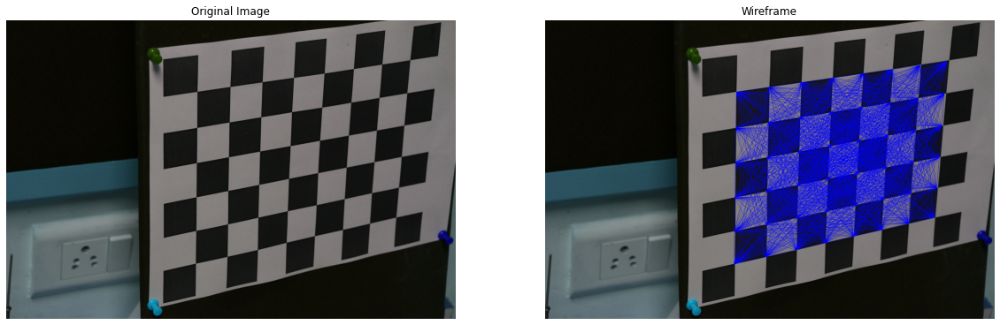

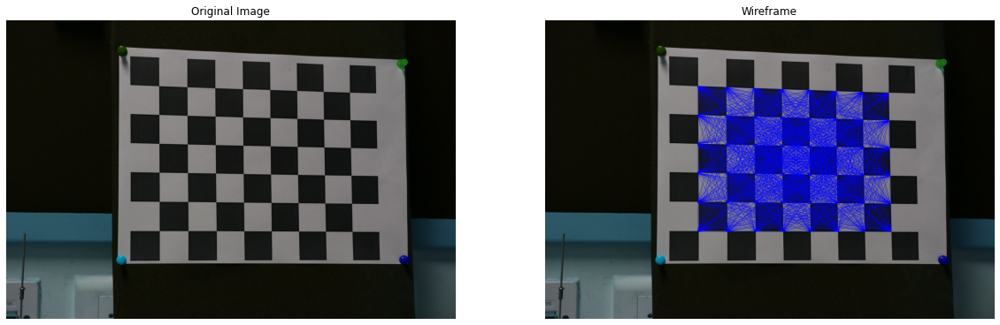

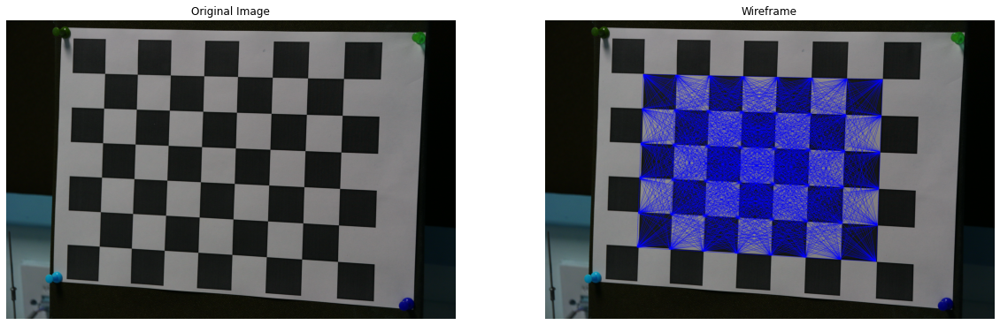

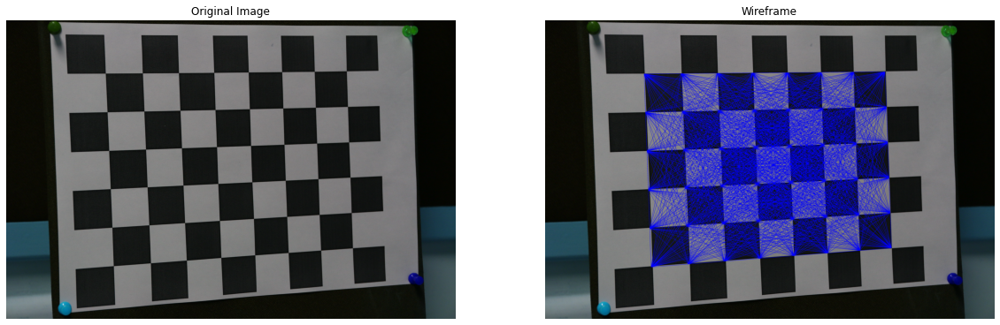

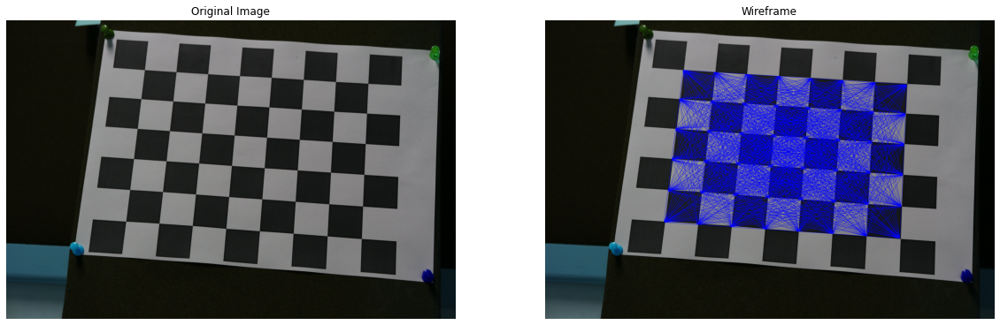

In [41]:
# wireframe of reprojected points in each checkerboard image using Zhangs
drawWireframes(world_points_homogenized, P_zhangs_list, dir_path)

## Observations

- The overlays fit almost perfectly for all images.
- The reprojected points in all images are very close to the actual locations of the image points.
- This indicates that the camera is well calibrated.
- Visually, the overlay fits better using Zhang's technique compared to DLT or RANSAC. This is in line with the observation that Zhang's method resulted in lower reprojection errors.

# Q8: Imaging World Origin

The last column of the camera matrix P gives the image of the origin in homogenous coordinates.

In [42]:
# image of origin using DLT and RANSAC
imaged_origin_dlt = P_dlt[:-1, -1]
imaged_origin_ransac = P_ransac[:-1, -1]

print("Image coordinates of world origin using DLT: \n", imaged_origin_dlt)
print("Image coordinates of world origin using RANSAC: \n", imaged_origin_ransac)

Image coordinates of world origin using DLT: 
 [4803.16190734 2169.59503162]
Image coordinates of world origin using RANSAC: 
 [4829.0868061  2218.55318109]


In [43]:
# image of origin in each checkerboard image using Zhangs
imaged_origins_zhangs = [P[:-1, -1] for P in P_zhangs_list]
print("Image coordinates of world origin using Zhangs (in each checkerboard image): \n", np.array(imaged_origins_zhangs))

Image coordinates of world origin using Zhangs (in each checkerboard image): 
 [[1061.40979066  588.03931573]
 [1335.94475515  659.79312731]
 [1491.21687683  564.21801804]
 [1327.13454659  608.02048266]
 [1381.20292381  790.66884206]
 [1801.87258814  627.57734555]
 [1681.77364713 1182.70560268]
 [1132.95180376 1025.03789947]
 [1301.08286651  694.28024965]
 [ 960.02787485  739.86816541]
 [2328.14387052  882.92037608]
 [1855.37306891  812.5942078 ]
 [1193.77786017  667.2499145 ]
 [1204.97649763  663.16116378]
 [1679.47559166  616.68682352]]


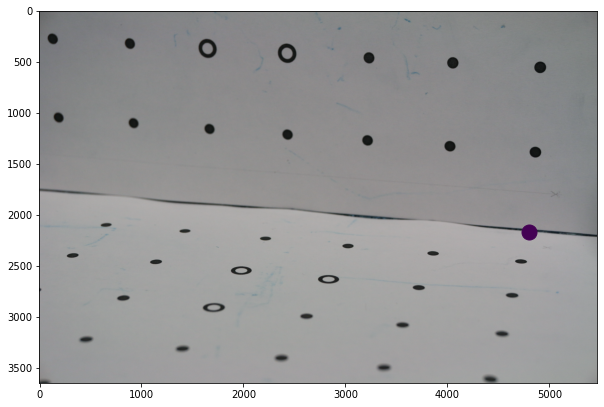

In [44]:
# reproject world origin (DLT)
show2DProjections([imaged_origin_dlt], img_path)

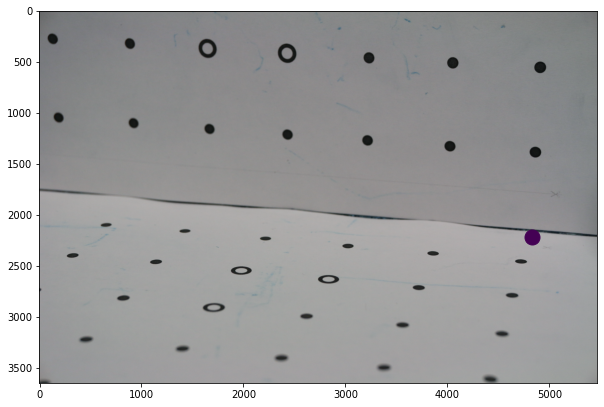

In [45]:
# reproject world origin (RANSAC)
show2DProjections([imaged_origin_ransac], img_path)

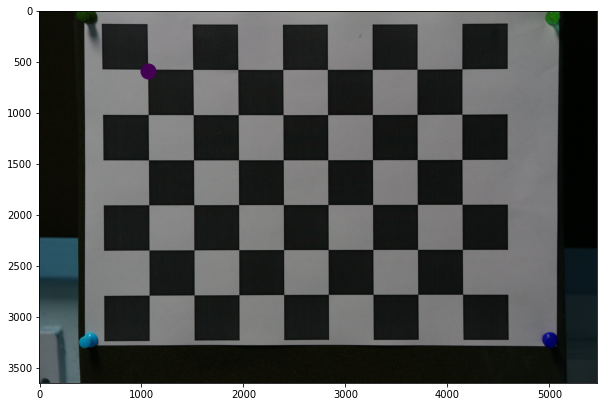

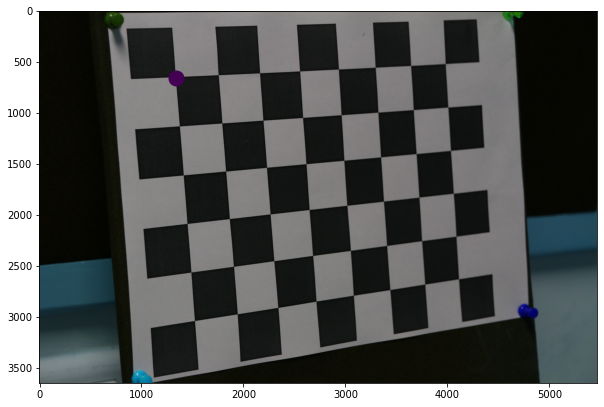

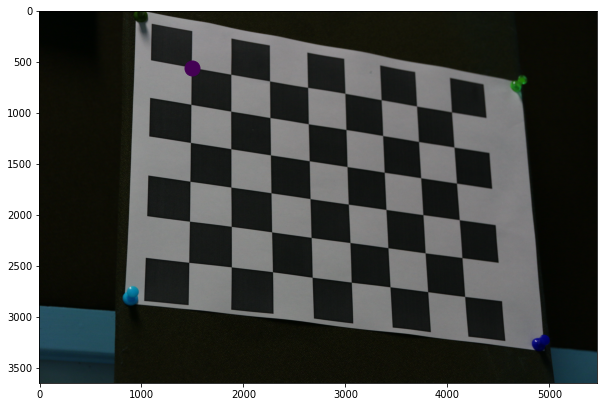

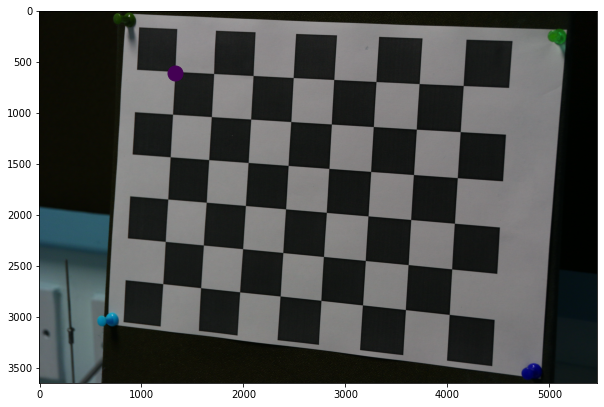

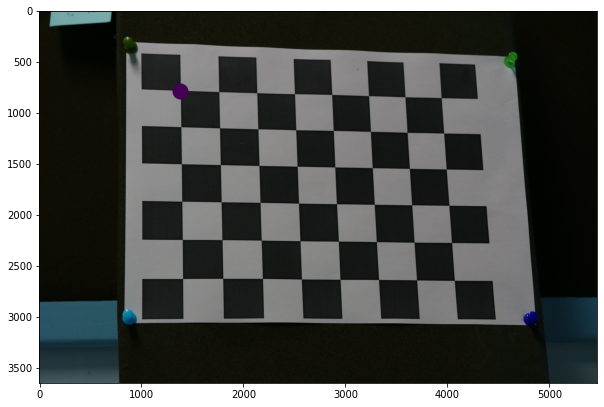

...

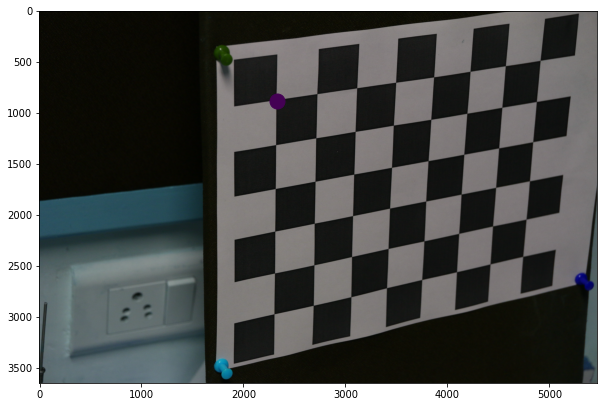

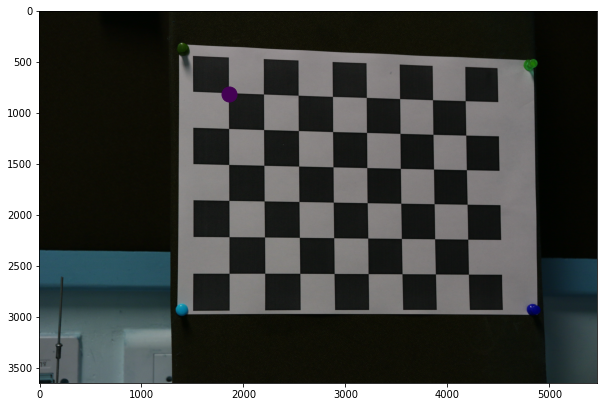

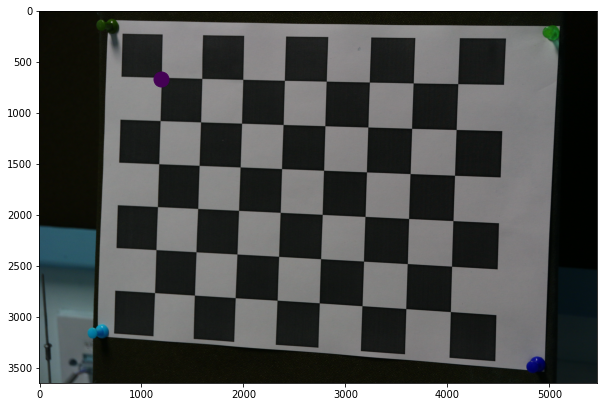

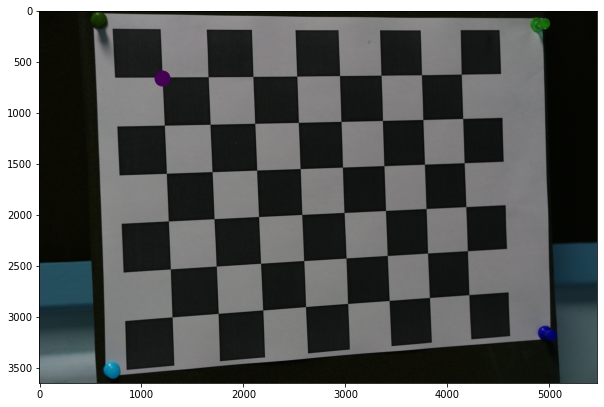

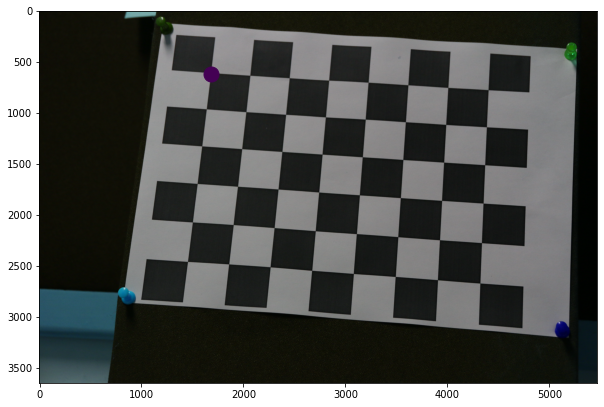

In [46]:
# reproject world origin for each checkerboard image (Zhangs)
showReprojectedPoints([[[0, 0, 0, 1]]] * len(P_zhangs_list), P_zhangs_list, dir_path)

## Observations

- In the above plots, we reproject the world origin and plot it in the image.
- The plots above confirm that the image of the world origin obtained is correct in all images.

# Q9

I will be using my phone camera (Redmi K20 main camera).

# Q10: Calibrate Chosen Camera

In [47]:
img_path = "../images/points.jpg"

# generate 2D correspondences for DLT
# image_points = getImagePoints(img_path)

# generated by getImagePoints
image_points = [[1883.038788958901, 1935.805219711519],
                [1271.7017319203987, 2671.673899480086],
                [664.138360419171, 2207.5105783952977],
                [456.5856558690625, 905.5890680355246],
                [1026.4121719975428, 430.10469033891195],
                [1607.5597447378468, 1358.431332508489],
                [1959.768987040538, 460.9819750601737],
                [189.23170648789073, 2570.1243115710454]]

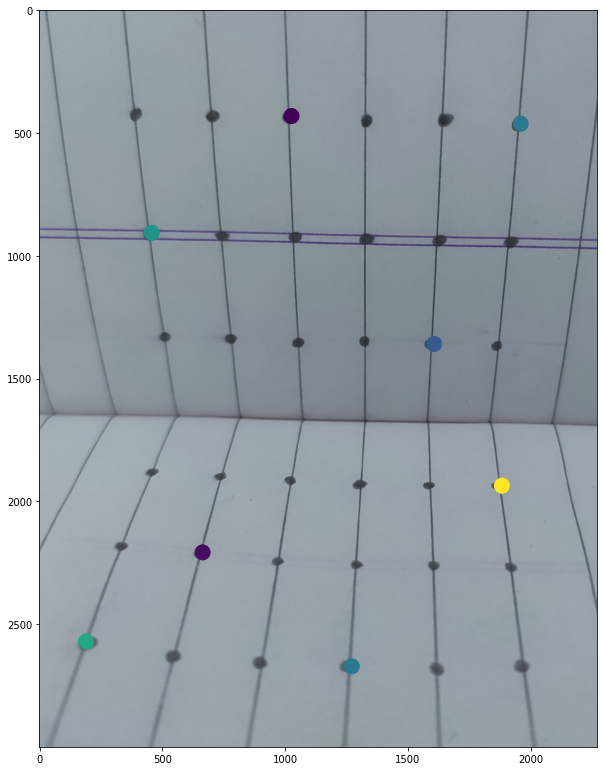

In [48]:
show2DProjections(image_points, img_path)

In [49]:
# all 2D correspondences
# x_all = getImagePoints(img_path)

# generated by getImagePoints
x_all = [[1962.28618524167, 456.5204890998348],
         [1652.8439711851433, 445.19943248801064],
         [1335.8543860540685, 445.19943248801064],
         [1022.6384864602678, 433.8783758761865],
         [709.4225868664676, 433.8783758761865],
         [392.4330017353923, 426.33100480163694],
         [1917.0019587943734, 947.0996089455466],
         [1630.201857961495, 939.552237870997],
         [1335.8543860540685, 932.0048667964475],
         [1045.280599683916, 928.2311812591729],
         [750.9331277764891, 920.6838101846233],
         [452.8119703317875, 913.1364391100742],
         [1879.265103421626, 1365.9787035830386],
         [1603.7860592005727, 1358.431332508489],
         [1335.8543860540685, 1347.110275896665],
         [1060.3753418330152, 1354.6576469712145],
         [788.6699831492365, 1335.7892192848408],
         [516.9646244654577, 1332.0155337475662],
         [1883.038788958901, 1939.5789052487937],
         [1600.0123736632977, 1935.805219711519],
         [1316.9859583676953, 1924.4841630996948],
         [1033.959543072092, 1913.163106487871],
         [747.1594422392145, 1898.068364338772],
         [467.90671248088665, 1879.1999366523985],
         [1932.0967009434717, 2267.8895469916934],
         [1615.1071158123968, 2260.3421759171433],
         [1298.117530681321, 2252.794804842594],
         [981.1279455502463, 2241.47374823077],
         [660.3646748818965, 2211.2842639325727],
         [343.3750897508212, 2177.3210940971003],
         [1981.1546129280432, 2664.126528405537],
         [1630.201857961495, 2675.4475850173612],
         [1267.9280463831237, 2667.9002139428117],
         [913.2016058793015, 2652.805471793713],
         [550.9277943009301, 2626.38967303279],
         [188.65398272255834, 2577.331761048219]]

# all 3D correspondences
X_all = []
for y in range(3, 0, -1):
    for x in range(0, 6):
        X_all.append([x, y, 0])

for z in range(1, 4):
    for x in range(0, 6):
        X_all.append([x, 0, z])
        
# homogenized correspondences
x_all_homogenized = homogenize(x_all)
X_all_homogenized = homogenize(X_all)

## Calibration using DLT and RANSAC

In [50]:
# 2D correspondences for DLT
x = image_points

# 3D correspondences for DLT
X = []
X.append([0, 0, 1])
X.append([2, 0, 3])
X.append([4, 0, 2])
X.append([5, 2, 0])
X.append([3, 3, 0])
X.append([1, 1, 0])
X.append([0, 3, 0])
X.append([5, 0, 3])

# homogenized correspondences
x_homogenized = homogenize(x)
X_homogenized = homogenize(X)

In [51]:
# calibration using DLT
P_dlt = DLT(x_homogenized, X_homogenized)
K_dlt, R_dlt, t_dlt = get_KRT_from_P(P_dlt)

print("P found using DLT: \n", P_dlt)
print("K found using DLT: \n", K_dlt)

P found using DLT: 
 [[-2.44049892e+02 -1.04165441e+02 -1.63277771e+02  1.83358858e+03]
 [-5.03947619e+00 -4.49362195e+02  2.83926993e+01  1.70450668e+03]
 [ 3.69343494e-03 -7.62361558e-02 -1.12105142e-01  1.00000000e+00]]
K found using DLT: 
 [[-1.83814192e+03 -1.15934997e+01  1.37790754e+03]
 [-0.00000000e+00 -2.85878704e+03  1.68845771e+03]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]


In [72]:
# calibration using RANSAC
P_ransac = ransac(x_all_homogenized, X_all_homogenized)
K_ransac, R_ransac, t_ransac = get_KRT_from_P(P_ransac)

print("P found using RANSAC: \n", P_ransac)
print("K found using RANSAC: \n", K_ransac)

P found using RANSAC: 
 [[-2.56071519e+02 -1.05033955e+02 -1.44295662e+02  1.84799742e+03]
 [-1.02428607e+01 -4.45258134e+02  6.52399415e+01  1.69644574e+03]
 [ 2.67254610e-13 -7.86267996e-02 -9.52380952e-02  1.00000000e+00]]
K found using RANSAC: 
 [[-2.07504606e+03  3.28137665e+01  1.44245031e+03]
 [-0.00000000e+00 -3.11765757e+03  1.88794978e+03]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]


In [73]:
# reprojection errors using DLT and RANSAC
print("Reprojection error using DLT: ", findReprojectionError(x_all_homogenized, X_all_homogenized, P_dlt))
print("Reprojection error using RANSAC: ", findReprojectionError(x_all_homogenized, X_all_homogenized, P_ransac))

Reprojection error using DLT:  15.777491047010137
Reprojection error using RANSAC:  20.895164082382085


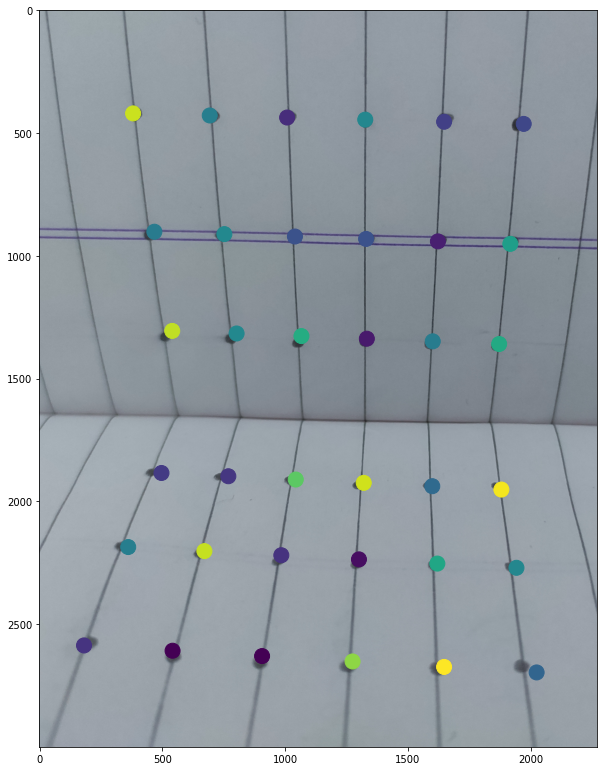

In [74]:
# reproject all world points using DLT
reprojected_points_dlt = getReprojectedPoints(X_all_homogenized, P_dlt)
show2DProjections(reprojected_points_dlt, img_path)

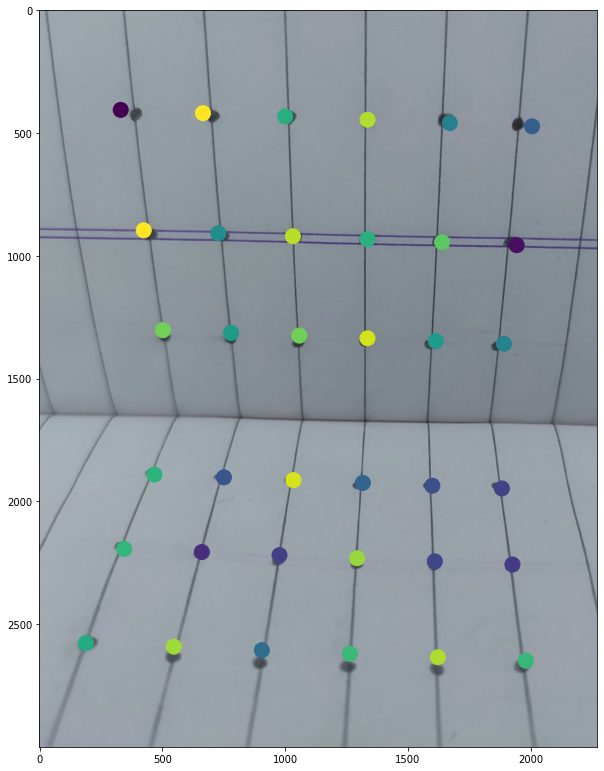

In [75]:
# reproject all world points using RANSAC
reprojected_points_ransac = getReprojectedPoints(X_all_homogenized, P_ransac)
show2DProjections(reprojected_points_ransac, img_path)

## Calibration using Zhang's Technique

Loading images...


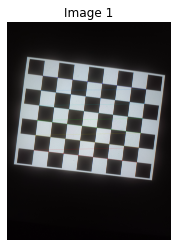

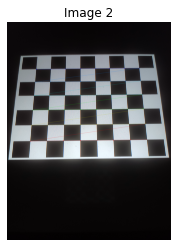

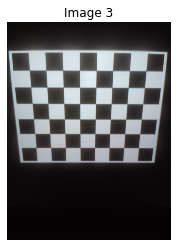

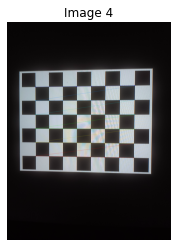

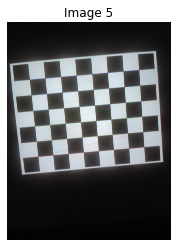

...

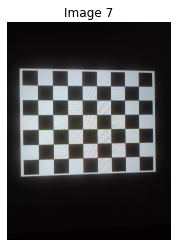

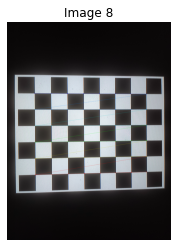

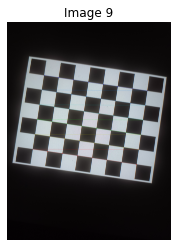

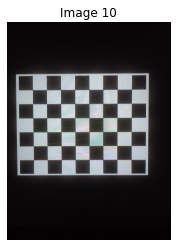

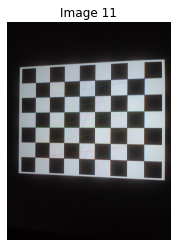

In [56]:
dir_path = "../images/checkerboard-*.jpg"

world_points, img_points, shape = findCheckerBoardCorners(dir_path)

In [57]:
# calibration using Zhangs
K_zhangs, rvecs, tvecs, P_zhangs_list, dist_coefs = zhangs(world_points, img_points, shape)
print("K found using Zhangs: \n", K_zhangs)

K found using Zhangs: 
 [[3.10283577e+03 0.00000000e+00 1.51564049e+03]
 [0.00000000e+00 3.10605163e+03 1.99839935e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


In [58]:
world_points_homogenized = [homogenize(points) for points in world_points]
img_points_homogenized = [homogenize(points) for points in np.squeeze(img_points)]    

In [59]:
# reprojection error for each checkerboard image using Zhangs
errors = findReprojectionErrors(world_points_homogenized, img_points_homogenized, P_zhangs_list, dir_path)
print("Reprojection errors using Zhangs: \n", np.array(errors))

Reprojection errors using Zhangs: 
 [3.20410272 3.27734914 3.4777425  3.49289793 3.14859925 3.15314379
 3.62077992 3.54375668 3.36316871 3.17317084 3.98013445]


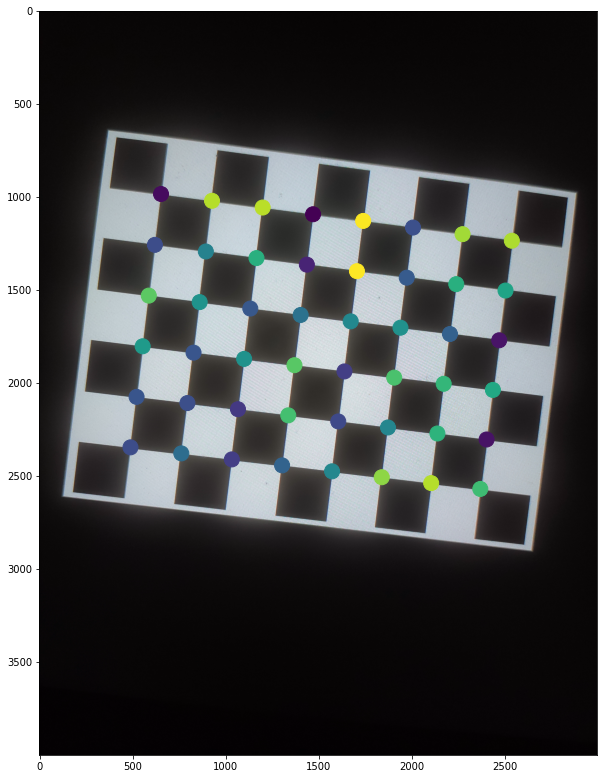

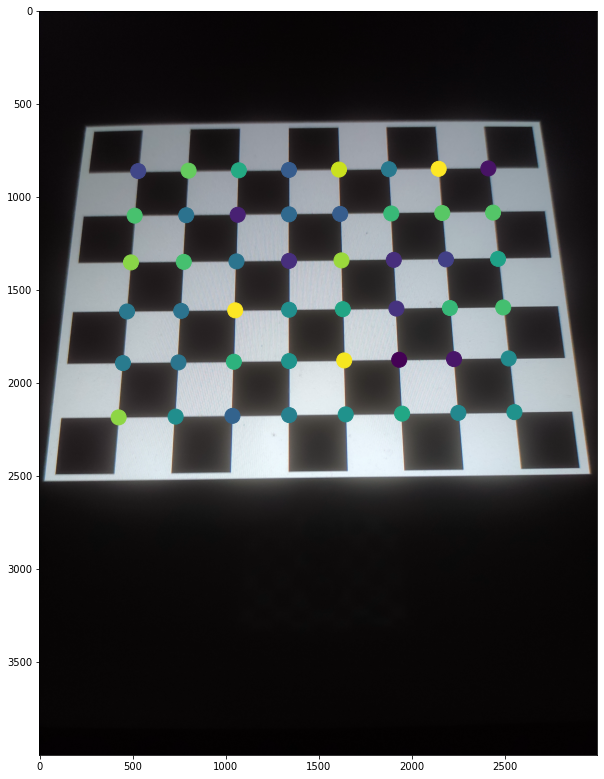

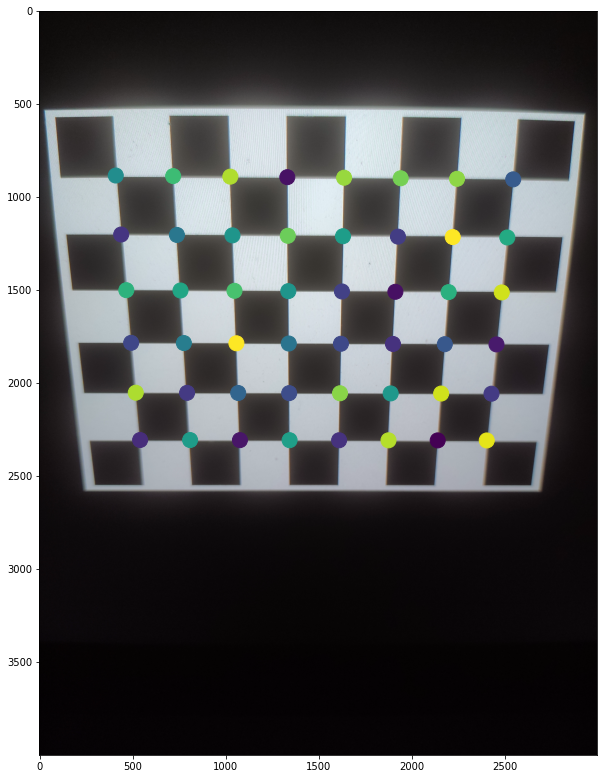

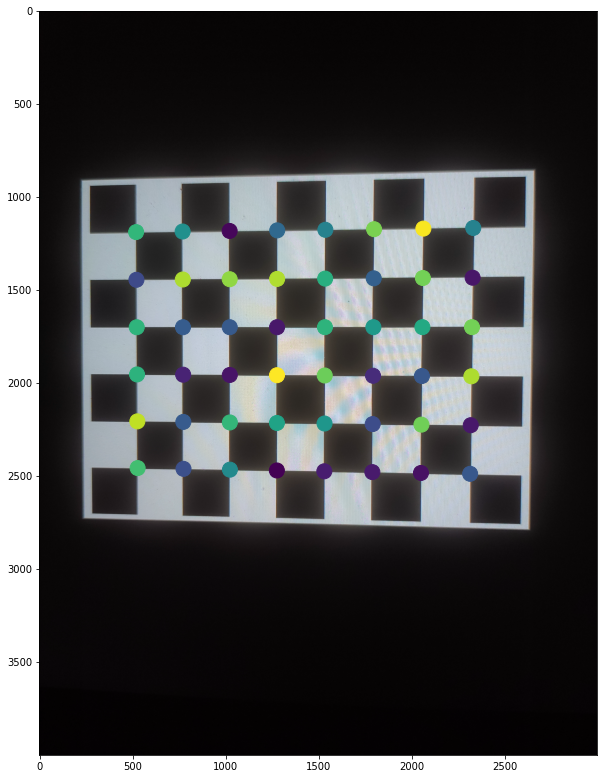

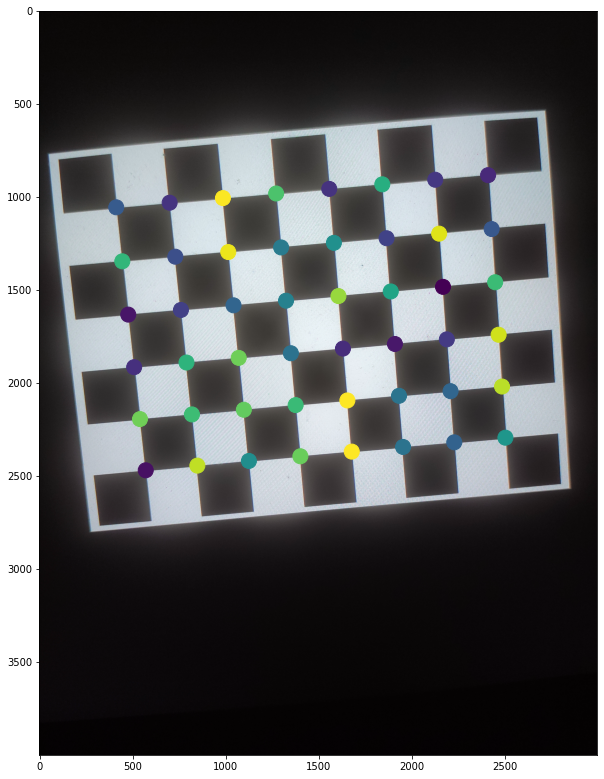

...

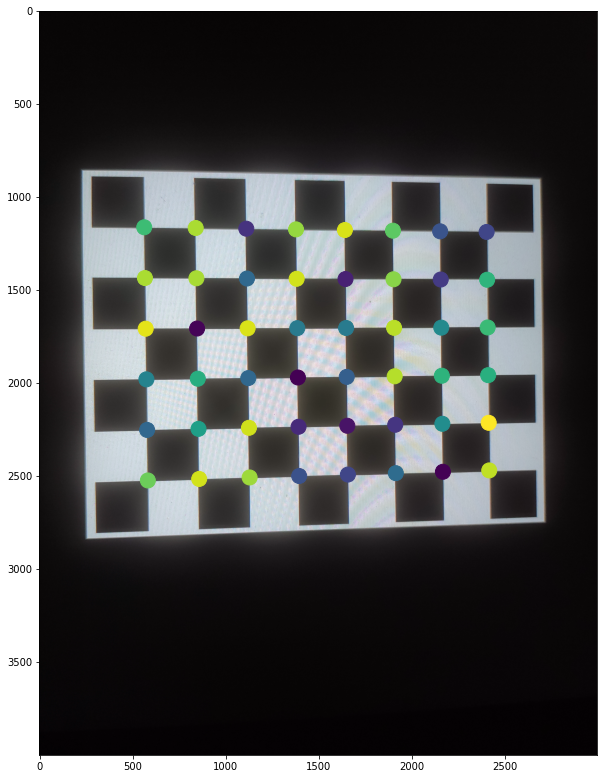

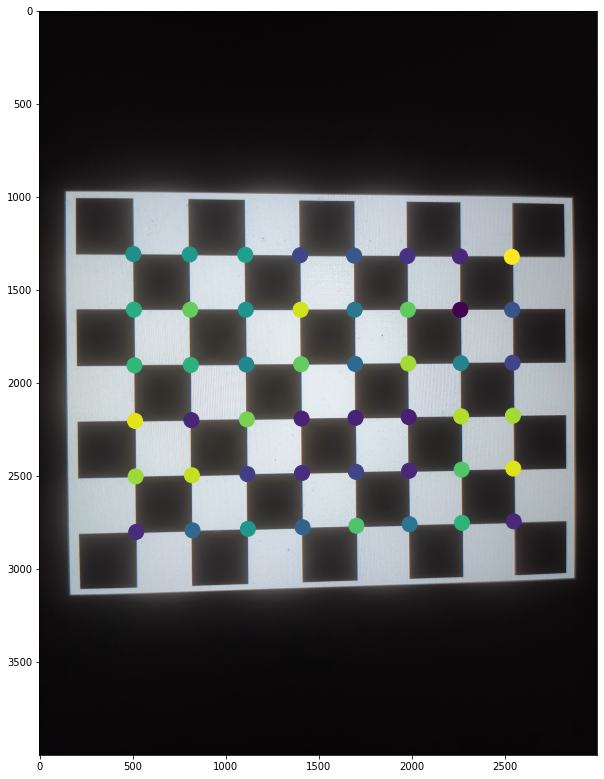

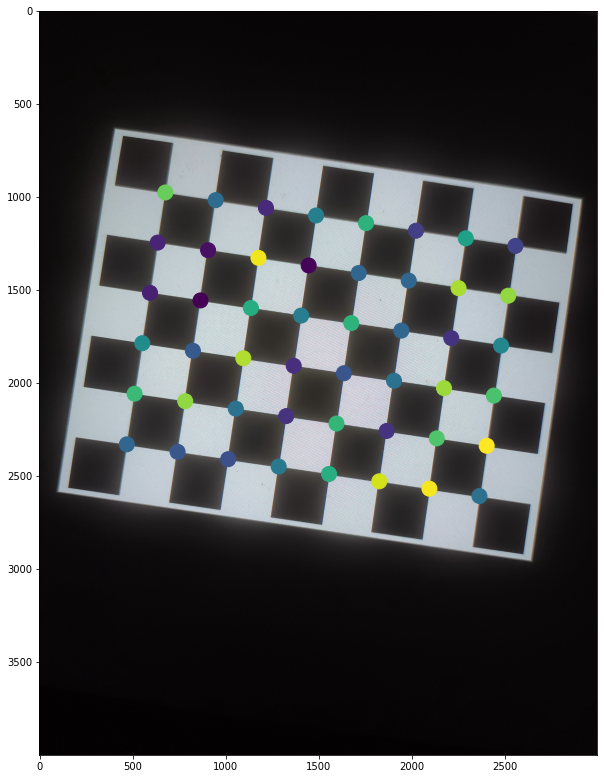

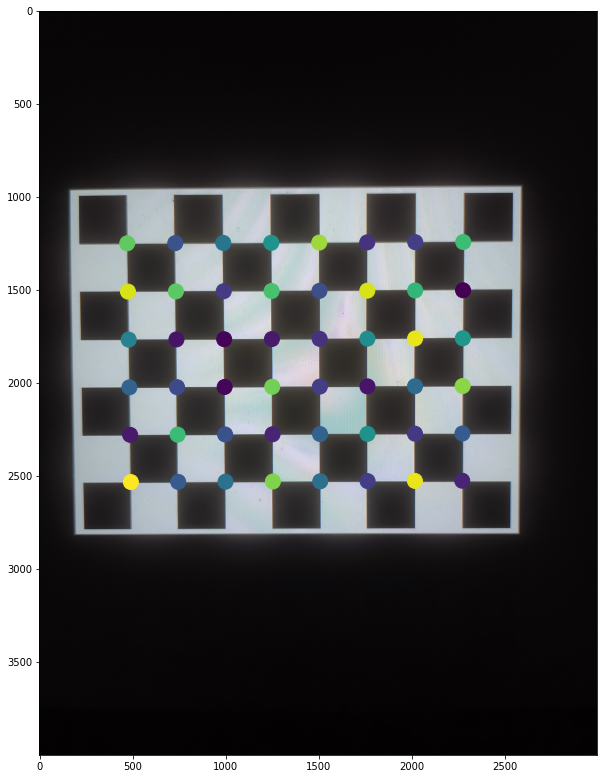

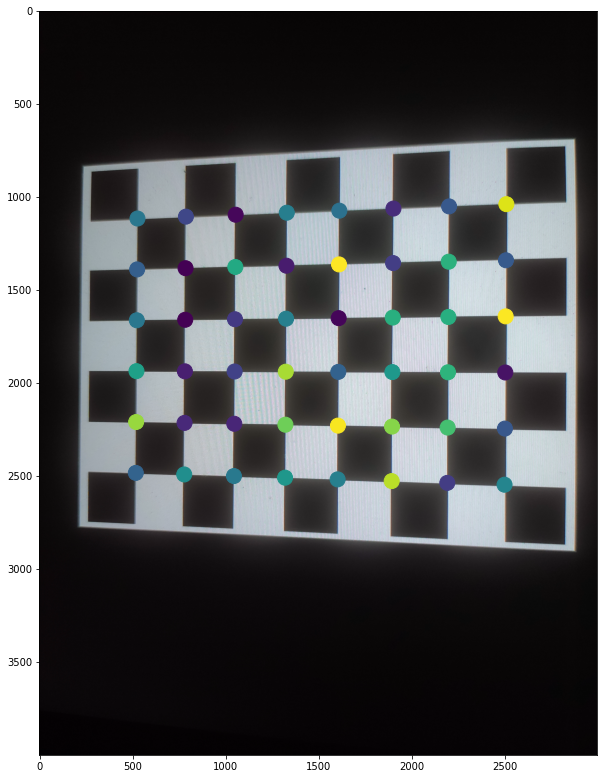

In [60]:
# reproject all world points for each checkerboard image
showReprojectedPoints(world_points_homogenized, P_zhangs_list, dir_path)

## Observations and results

Zhang's method performs the best, followed by DLT and then RANSAC.
In the image used for calibration using DLT and RANSAC, barrel distortion is evident. This contributes to greater reprojection errors when compared to Zhang's.

### Zhangs method
- Zhang's method gives the lowest reprojection errors, between 3 and 4. Reprojected points are very close to the original image points, as seen in the plots above. The camera in this case is well calibrated.

### DLT
- DLT with the chosen correspondences gives a reprojection error of 15.777491047010137.
- The reprojection error increased by using 8 correspondences instead of 6.
- With 6 correspondences, the reprojection error was 23.55479993493381.
- The reprojected image points when plotted are generally close to the original image points. The camera is fairly well calibrated.

### RANSAC
- RANSAC performs the worst on average, but sometimes gives a lower reprojection error than DLT.
- The reprojection error is usually in the range of 20 to 40.
- With higher reprojection errors, the reprojected image points are visibly shifted away from their ground truth locations.
- In cases where RANSAC gives a high reprojection error, this is probably due to the random correspondences not covering the entire image, but rather being localized in a subregion of the image. When such a case is plotted, projections will overlap well in some areas but poorly in other areas.